In [1]:
from bs4 import BeautifulSoup
from IPython.display import clear_output
import numpy as np
import pandas as pd
from requests import get
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
# Carga la página con los enlaces a los datos históricos en formato html
url_site = "https://coinmarketcap.com/"
url_page = url_site + "es/historical/"
page = get(url_page)
soup = BeautifulSoup(page.content, 'html.parser')

In [3]:
# Recopila todos los enlaces de la página 
links = [a['href'] for a in soup.find_all('a', href=True)]
# y selecciona aquellos que tienen el formato que lleva a los históricos
history_links = [link for link in links \
           if link[:15] == '/es/historical/' and len(link)>15]

In [4]:
# Recorre todos los enlaces a datos históricos
cap_history = {}
for date_link in history_links:
    hurl = url_site + date_link
    date = pd.to_datetime(date_link[15:-1]).date()
    remaining = len(history_links) - len(cap_history)
    clear_output(wait = True)
    print(f'   Descargando datos de fecha : {date} \n' +
          f'   Semanas pendientes: {remaining}')
    # conviente la tabla html con los datos en un dataframe de Pandas
    # y lo guarda como un elemento del diccionario
    cap_history[date] = pd.read_html(hurl)[0].set_index('#')
# Concatena los elementos del diccionario en un único dataframe de Pandas
data = pd.concat(cap_history)
clear_output(wait = True)
print(f'Descarga de {len(history_links)} completada')

Descarga de 332 completada


In [5]:
# Tamaño del dataframe
data.shape

(293958, 10)

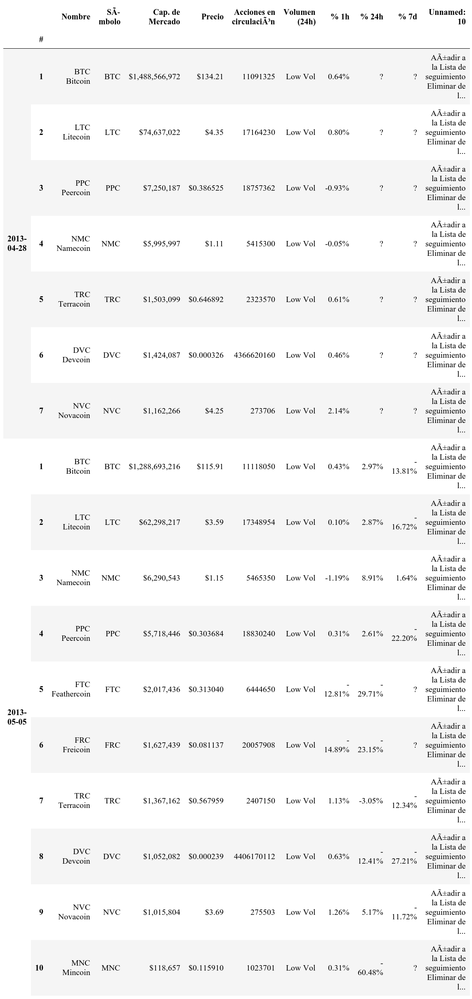

In [6]:
# Visualiza el comienzo del dataframe
data.head(17)

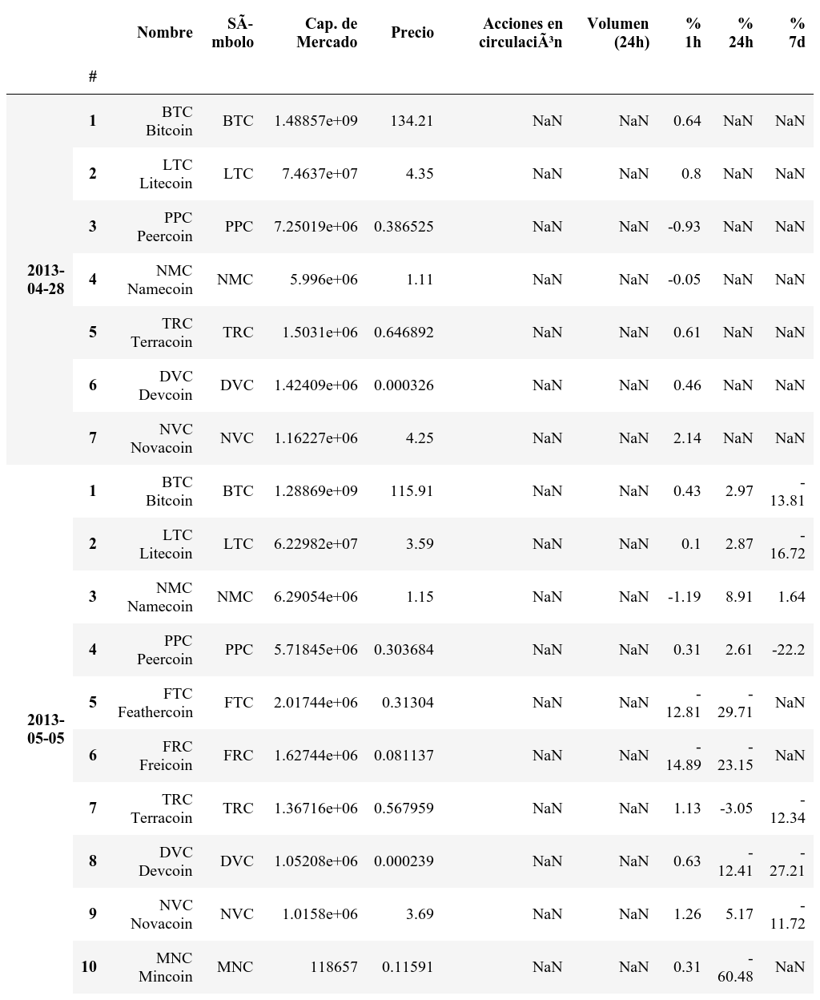

In [7]:
# Formatea adecuadamente los datos númericos del dataframe
data.drop('Unnamed: 10', axis=1, inplace=True)
data.iloc[:,2:] = data.iloc[:,2:].apply(lambda x: x.str.replace('[%$,* ]', ''))
data.iloc[:,2:] = data.iloc[:,2:].apply(lambda x: x.replace('?', np.nan))
data['Volumen (24h)'] = data['Volumen (24h)'].replace('LowVol', np.nan)
data[['% 24h', '% 7d']] = data[['% 24h', '% 7d']].replace('>9000', np.nan)
data.iloc[:,2:] = data.iloc[:,2:].astype(float)
# Visualiza el comienzo del dataframe ahora correctamente formateados
data.head(17)

In [8]:
# Guarda los datos en formato Excel
data.to_excel('CoinMarketCap historico.xlsx')

In [125]:
data.to_pickle('Articul Historico de mercados cryptos coinmarketcap 25082019.pkl')

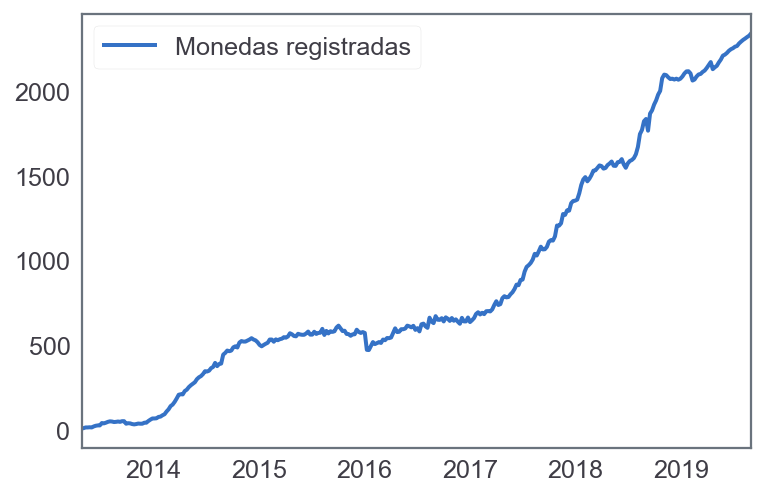

In [14]:
# Visualiza la evolución del número de monedas recogidas en el histórico
numero_monedas = data.groupby(axis=0, level=0).Nombre.count()
numero_monedas.plot(label='Monedas registradas', linewidth=2)
plt.legend();

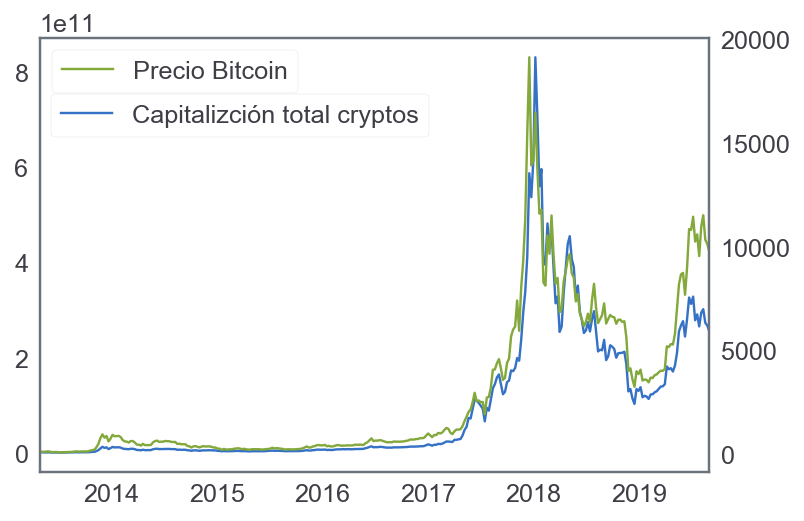

In [63]:
cap_total = data.groupby(axis=0, level=0)['Cap. de Mercado'].sum().to_frame('Capitalizción total cryptos')
bitcoin = data.droplevel(1)[data.droplevel(1)['Nombre'].eq('BTC Bitcoin')]
precio_bitcoin = bitcoin['Precio']
fig, ax = plt.subplots()
cap_total.plot(ax=ax, label='Capitalizción total cryptos')
precio_bitcoin.plot(ax=ax, secondary_y=True, label='Precio Bitcoin')
ax.get_legend().set_bbox_to_anchor((0.6, 0.9))
plt.legend();

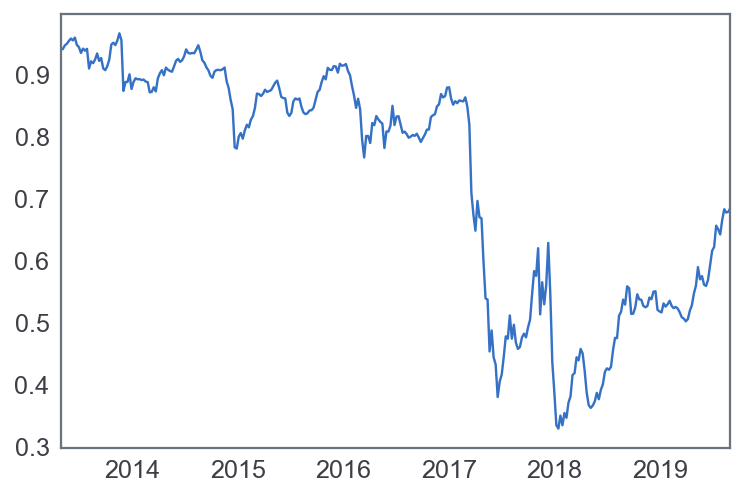

In [64]:
bitcoin_peso = bitcoin['Cap. de Mercado'].div(cap_total.squeeze())
bitcoin_peso.plot()